## **ONLINE RETAIL DATASET**

**<H3>THIS NOTEBOOK CONTAINS PREPROCESSING, VISUALIZATION AND COLLABORATIVE FILTERING</H3>**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from bokeh.plotting import figure
from bokeh.io import show, output_notebook
sns.set_style("whitegrid")
sns.set_palette("bright")
from sklearn.preprocessing import StandardScaler

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/PravinSabariBala/Business-Analysis-on-UCI-sales-dataset/main/Final_dataset.csv")

In [3]:
df

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,01-12-2009 07:45,6.95,13085.0,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,01-12-2009 07:45,6.75,13085.0,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,01-12-2009 07:45,6.75,13085.0,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,01-12-2009 07:45,2.10,13085.0,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,01-12-2009 07:45,1.25,13085.0,United Kingdom
...,...,...,...,...,...,...,...,...
1067366,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,09-12-2011 12:50,2.10,12680.0,France
1067367,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,09-12-2011 12:50,4.15,12680.0,France
1067368,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,09-12-2011 12:50,4.15,12680.0,France
1067369,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,09-12-2011 12:50,4.95,12680.0,France


# Preprocessing

In [4]:
df.shape

(1067371, 8)

In [5]:
df.columns

Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')

In [6]:
df.columns = [s.strip().replace(" " , "_") for s in df.columns]


In [7]:
df.columns

Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer_ID', 'Country'],
      dtype='object')

In [8]:
df.dtypes

Invoice         object
StockCode       object
Description     object
Quantity         int64
InvoiceDate     object
Price          float64
Customer_ID    float64
Country         object
dtype: object

In [9]:
df.isna().sum()

Invoice             0
StockCode           0
Description      4382
Quantity            0
InvoiceDate         0
Price               0
Customer_ID    243007
Country             0
dtype: int64

<Axes: >

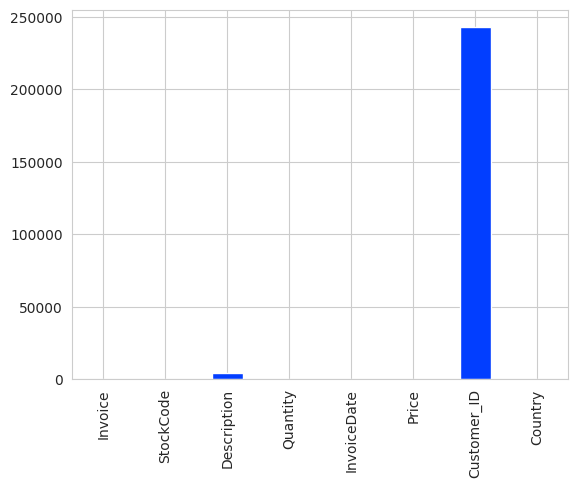

In [10]:
df.isna().sum().plot.bar()

In [11]:
df.dropna(subset=['Customer_ID', 'Description'], inplace=True)

In [12]:
df.isna().sum()

Invoice        0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
Price          0
Customer_ID    0
Country        0
dtype: int64

In [13]:
df.describe()

,Quantity,Price,Customer_ID
count,824364.000000,824364.000000,824364.000000
mean,12.414574,3.676800,15324.638504
std,188.976099,70.241388,1697.464450
min,-80995.000000,0.000000,12346.000000
25%,2.000000,1.250000,13975.000000
50%,5.000000,1.950000,15255.000000
75%,12.000000,3.750000,16797.000000
max,80995.000000,38970.000000,18287.000000


In [14]:
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

In [15]:
df = df.drop(["InvoiceDate"], axis=1)

In [16]:
df["Country"].unique()

array(['United Kingdom', 'France', 'USA', 'Belgium', 'Australia', 'EIRE',
       'Germany', 'Portugal', 'Japan', 'Denmark', 'Netherlands', 'Poland',
       'Spain', 'Channel Islands', 'Italy', 'Cyprus', 'Greece', 'Norway',
       'Austria', 'Sweden', 'United Arab Emirates', 'Finland',
       'Switzerland', 'Unspecified', 'Nigeria', 'Malta', 'RSA',
       'Singapore', 'Bahrain', 'Thailand', 'Israel', 'Lithuania',
       'West Indies', 'Korea', 'Brazil', 'Canada', 'Iceland', 'Lebanon',
       'Saudi Arabia', 'Czech Republic', 'European Community'],
      dtype=object)

In [17]:
len(pd.unique(df['Country']))

41

In [18]:
len(pd.unique(df['Description']))

5299

In [19]:
len(pd.unique(df['StockCode']))

4646

In [20]:
df1 = pd.get_dummies(df, columns=["Country"])

In [21]:
df1

,Invoice,StockCode,Description,Quantity,Price,Customer_ID,Country_Australia,Country_Austria,Country_Bahrain,Country_Belgium,...,Country_Singapore,Country_Spain,Country_Sweden,Country_Switzerland,Country_Thailand,Country_USA,Country_United Arab Emirates,Country_United Kingdom,Country_Unspecified,Country_West Indies
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,6.95,13085.0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,489434,79323P,PINK CHERRY LIGHTS,12,6.75,13085.0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,489434,79323W,WHITE CHERRY LIGHTS,12,6.75,13085.0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2.10,13085.0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,1.25,13085.0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1067366,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2.10,12680.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1067367,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,4.15,12680.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1067368,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,4.15,12680.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1067369,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,4.95,12680.0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# VISUALIZATION

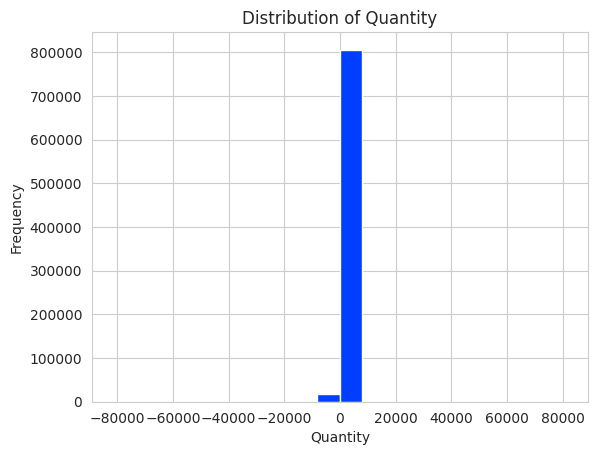

In [22]:
plt.hist(df["Quantity"], bins=20)
plt.xlabel("Quantity")
plt.ylabel("Frequency")
plt.title("Distribution of Quantity")
plt.show()


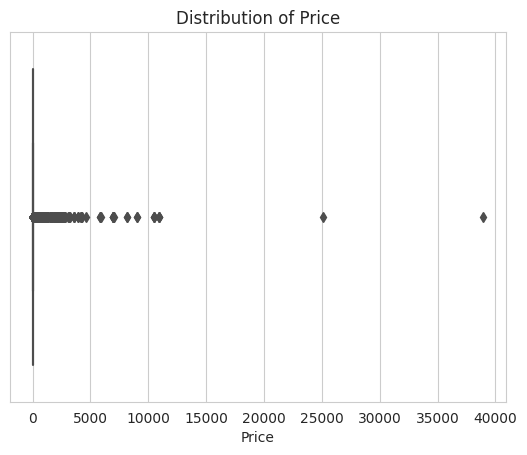

In [23]:
sns.boxplot(x=df["Price"])
plt.xlabel("Price")
plt.title("Distribution of Price")
plt.show()

In [24]:
# plt.scatter(x=df["Quantity"], y=df["Price"])
# plt.xlabel("Quantity")
# plt.ylabel("Price")
# plt.title("Quantity vs Price")
# plt.show()

In [25]:
# plt.figure(figsize=(10, 6))
# sns.barplot(x="Country", y="Quantity", data=df, estimator=sum)
# plt.xticks(rotation=90)
# plt.xlabel("Country")
# plt.ylabel("Total Quantity")
# plt.title("Total Quantity of Items Sold by Country")
# plt.show()


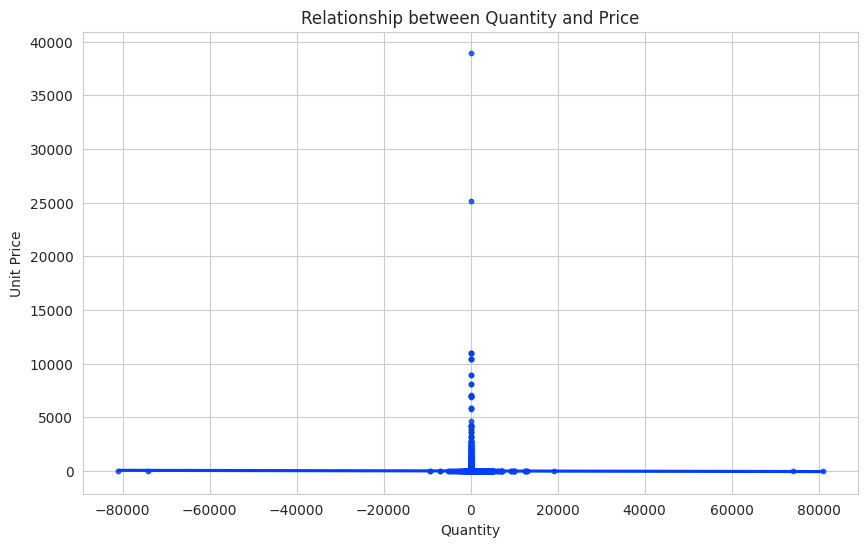

In [26]:
plt.figure(figsize=(10, 6))
sns.regplot(x="Quantity", y="Price", data=df, scatter_kws={"s": 10})
plt.xlabel("Quantity")
plt.ylabel("Unit Price")
plt.title("Relationship between Quantity and Price")
plt.show()


In [27]:
# sns.pairplot(df.select_dtypes(include=[np.number]), diag_kind="hist")
# plt.show()

In [28]:
fig = px.bar(df.groupby("Country")["Quantity"].sum().reset_index(), x="Country", y="Quantity")
fig.update_layout(title="Quantity by Country")
fig.show()

In [29]:
fig = px.box(df, x="Country", y="Price")
fig.update_layout(title="Price by Country")
fig.show()

In [30]:
fig = px.scatter(df, x="Quantity", y="Price", color="Country")
fig.update_layout(title="Quantity vs Price by Country")
fig.show()

In [31]:
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource
from bokeh.layouts import column

source = ColumnDataSource(df)

p = figure(title="Relationship between Quantity and Price", 
           x_axis_label="Quantity", y_axis_label="Price", 
           plot_width=600, plot_height=400)

p.circle(x="Quantity", y="Price", source=source, size=5, color="blue")
show(p)

In [32]:
from bokeh.palettes import Category10
from bokeh.transform import factor_cmap

grouped = df.groupby("Country")["Quantity"].sum().reset_index()

p = figure(title="Total Quantity of Items Sold by Country", 
           x_axis_label="Country", y_axis_label="Total Quantity", 
           x_range=grouped["Country"].tolist(), plot_width=600, plot_height=400)

p.vbar(x="Country", top="Quantity", source=grouped, width=0.5, 
       color=factor_cmap("Country", palette=Category10[10], factors=grouped["Country"].unique().tolist()))

p.xaxis.major_label_orientation = 1.2
show(p)

# **collaborative and content based filtering**

In [33]:
#pip install surprise

In [34]:
from surprise import SVD
from surprise import Dataset
from surprise import Reader
from surprise.model_selection import train_test_split

reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[["Customer_ID", "StockCode", "Quantity"]], reader)

trainset, testset = train_test_split(data, test_size=0.2)

algo = SVD()
algo.fit(trainset)

predictions = algo.test(testset)

from surprise import accuracy
accuracy.rmse(predictions)


RMSE: 198.7006


198.7006032852584

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

tfidf = TfidfVectorizer(stop_words="english")

# Fit the vectorizer to the "Description" column
tfidf_matrix = tfidf.fit_transform(df["Description"])

# Compute the cosine similarity between all pairs of products
cosine_sim = cosine_similarity(tfidf_matrix, tfidf_matrix)

# Define a function to get the top N most similar products
def get_similar_products(product_name, N=5):
    # Get the index of the product
    idx = df[df["Description"] == product_name].index[0]
    
    # Get the cosine similarity scores for all products
    sim_scores = list(enumerate(cosine_sim[idx]))
    
    # Sort the scores in descending order
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    
    # Get the indices of the top N most similar products
    sim_indices = [i[0] for i in sim_scores[1:N+1]]
    
    # Return the top N most similar products
    return df.iloc[sim_indices]["Description"].tolist()

print(get_similar_products("SET/6 RED SPOTTY PAPER PLATES"))
